In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from models.autoencoder import DenseAutoencoder
from models.flows import MAF
from models.nn import PaeBuilder

import tensorflow as tf
import tensorflow_probability as tfp
import tensorflow.keras as tfk
print(tf.__version__)

2.4.1


In [40]:
from loaders.LHCO import LhcoRnDLoader
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer

scaler = QuantileTransformer(output_distribution='uniform')

files = {
    'bkg':'../data/3jet/RnD/bkgHLF_merged.h5',
    'sig1':'../data/3jet/RnD/sigHLF_merged.h5',
}

train_fractions = {
    'bkg':1
}

test_fractions = {
    'bkg':.5,
    'sig1':.5
}

loader = LhcoRnDLoader(files, 'trijet', scaler, exclude=['mjj', 'mjjj'])
loader.preprocessing('bkg')
train = loader.make_train_val(250_000, train_fractions, val_split=.2)
test = loader.make_test(100_000, test_fractions, replace=False)

dataset = {**train, **test}
del train, test

In [41]:
trijet_mask_train = (dataset['mjj_train'] != dataset['mjjj_train'])
trijet_mask_valid = (dataset['mjj_valid'] != dataset['mjjj_valid'])
trijet_mask_test = (dataset['mjj_test'] != dataset['mjjj_test'])

for key in dataset.keys():
    if '_train' in key:
        dataset[key] = dataset[key][trijet_mask_train]
    elif '_valid' in key:
        dataset[key] = dataset[key][trijet_mask_valid]
    elif '_test' in key:
        dataset[key] = dataset[key][trijet_mask_test]
    elif key == 'labels':
        dataset[key] = dataset[key][trijet_mask_test]

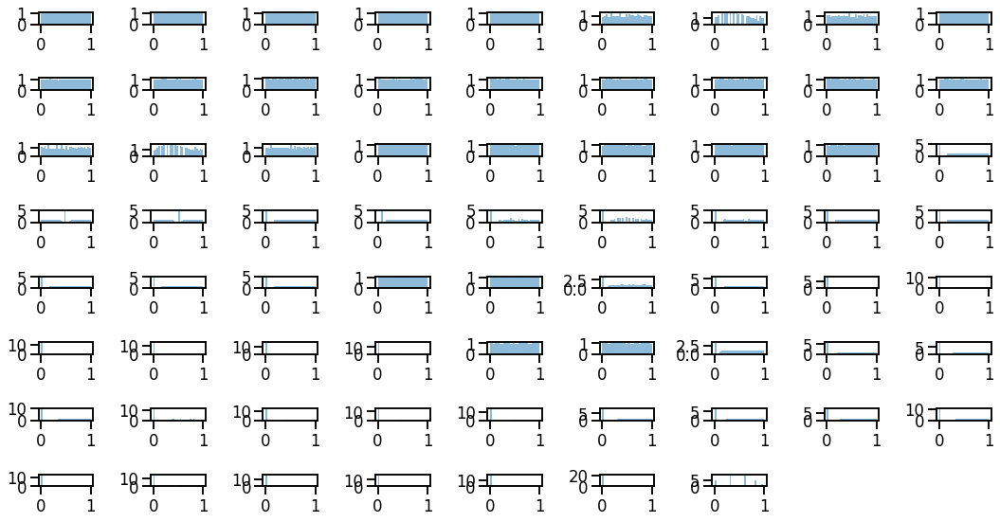

In [21]:
from utils.plotting import feature_plots

feature_plots(dataset['x_train'])

CPU times: user 1min 36s, sys: 1min 46s, total: 3min 22s
Wall time: 36.9 s


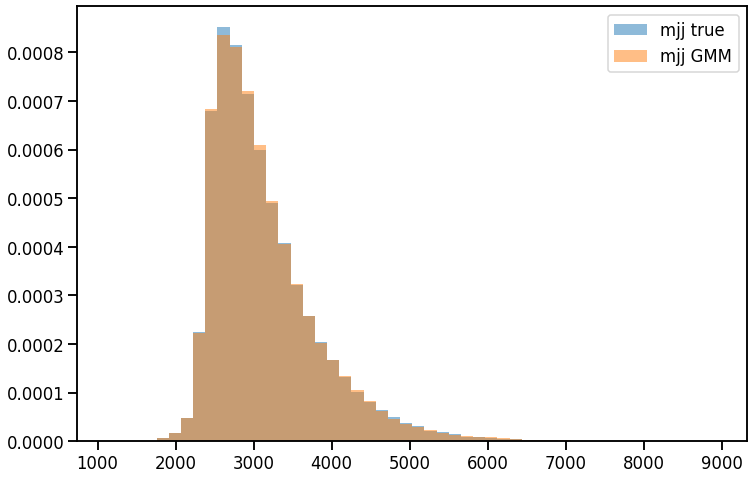

In [42]:
from sklearn.mixture import GaussianMixture
GMM = GaussianMixture

%time gmm = GMM(n_components=350, covariance_type='full').fit(dataset["mjj_train"].reshape(-1,1))
plt.figure(figsize=(12,8))
_, b, _ = plt.hist(dataset["mjj_train"], bins=50, label='mjj true', alpha=.5, density=True)
sample = gmm.sample(dataset["mjj_train"].shape[0])
plt.hist(sample[0], bins=b, label='mjj GMM', alpha=.5, density=True)
plt.legend()
plt.show()

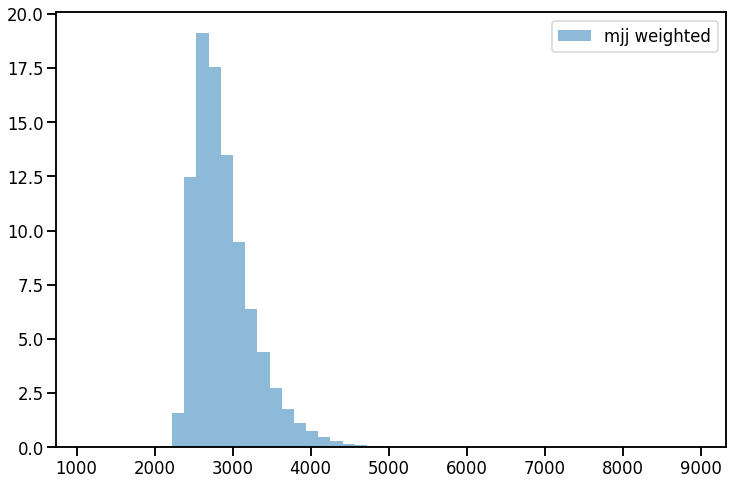

In [43]:
weights2 = gmm.score_samples(dataset["mjj_train"].reshape(-1,1))
weights2_valid = gmm.score_samples(dataset["mjj_valid"].reshape(-1,1))
plt.figure(figsize=(12,8))
_, b, _ = plt.hist(dataset["mjj_train"], bins=50, label='mjj weighted', alpha=.5, weights=np.exp(weights2))
plt.legend()
plt.show()

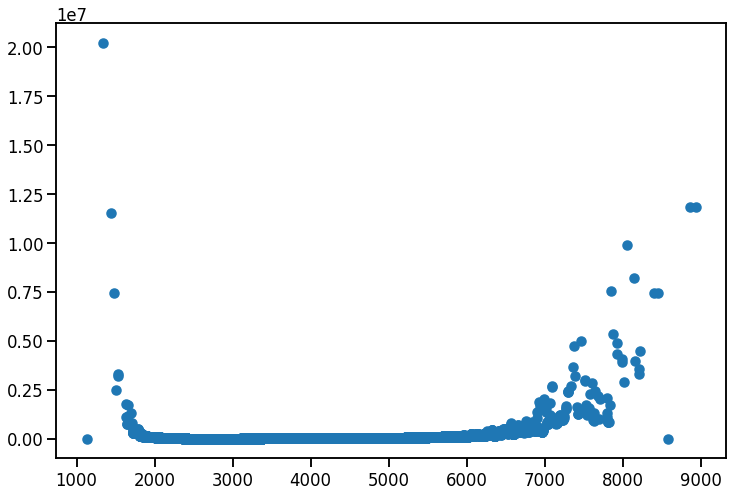

In [44]:
plt.figure(figsize=(12,8))
plt.scatter(dataset["mjj_train"], 1/np.exp(weights2))
plt.show()

In [45]:
import tensorflow as tf
import tensorflow_probability as tfp
import tensorflow.keras as tfk
import numpy as np
import sys

tfd = tfp.distributions
tfb = tfp.bijectors
tfkl = tfk.layers

sys.path.append('../')

from models.autoencoder import DenseAutoencoder
from models.flows import MAF

In [46]:
builder = PaeBuilder()

ae_config = {
    'input_dim':70, 
    'encoding_dim':15, 
    'units_list':[50, 35, 20],
    'weight_reg':tfk.regularizers.l1(1e-6),
    'output_activation':tf.nn.sigmoid
}
nf_config = {
    'n_dims':15, 
    'n_layers':6, 
    'units':[32 for i in range(4)]
}
optimizer_ae = {
    'lr': 0.05
}
optimizer_nf = {
    'lr': 0.005
}

builder.make_ae_model(DenseAutoencoder, ae_config)
builder.make_nf_optimizer(tfk.optimizers.Adam, optimizer_ae)
builder.make_nf_model(MAF, nf_config)
builder.make_nf_optimizer(tfk.optimizers.Adam, optimizer_nf)
builder.compile_ae()
builder.compile_nf()
pae = builder.pae

In [47]:
ae_train ={
    'batch_size':200,
    'epochs':180,
    'sample_weight':1/np.exp(weights2),
    'validation_data':(dataset["x_valid"],dataset["x_valid"],1/np.exp(weights2_valid)),
    'callbacks':tfk.callbacks.ReduceLROnPlateau(
        factor=0.2,
        patience=10,
        verbose=1
    )
}

nf_train ={
    'batch_size':200,
    'epochs':100,
    'validation_data':(dataset["x_valid"],dataset["x_valid"]),
    'callbacks':tfk.callbacks.ReduceLROnPlateau(
        factor=0.2,
        patience=5,
        verbose=1
    )
}
with tf.device("/device:CPU:0"):
    %time pae.fit(dataset["x_train"],ae_train,nf_train)

: 93451836194816.0000
Epoch 109/180
842/842 [==============================] - 1s 1ms/step - loss: 264.9719 - val_loss: 93703695761408.0000
Epoch 110/180
842/842 [==============================] - 1s 2ms/step - loss: 260.1758 - val_loss: 93458949734400.0000
Epoch 111/180
842/842 [==============================] - 1s 2ms/step - loss: 263.8584 - val_loss: 93516076154880.0000
Epoch 112/180
842/842 [==============================] - 1s 2ms/step - loss: 261.2325 - val_loss: 93100043141120.0000

Epoch 00112: ReduceLROnPlateau reducing learning rate to 8.000000525498762e-06.
Epoch 113/180
842/842 [==============================] - 2s 2ms/step - loss: 265.8978 - val_loss: 93495549231104.0000
Epoch 114/180
842/842 [==============================] - 2s 2ms/step - loss: 257.7250 - val_loss: 93673345777664.0000
Epoch 115/180
842/842 [==============================] - 2s 2ms/step - loss: 267.8608 - val_loss: 93649740234752.0000
Epoch 116/180
842/842 [==============================] - 1s 2ms/step - 

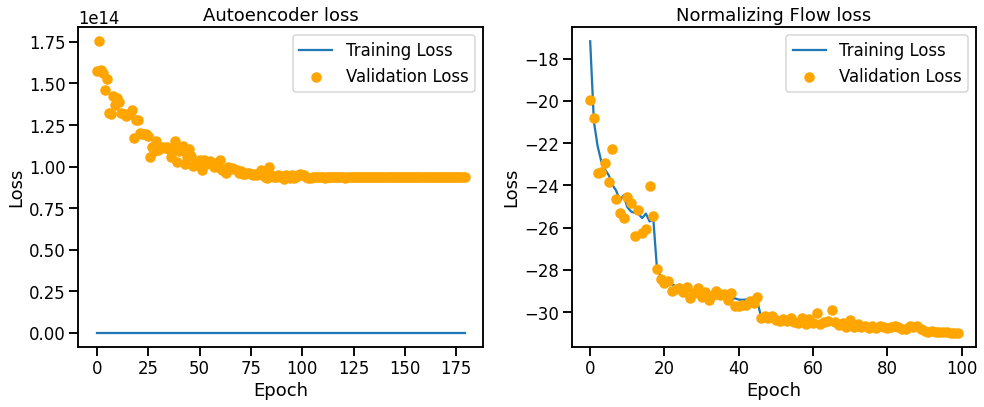

In [48]:
from utils.plotting import loss_plot, latent_space_plot, mjj_cut_plot, \
                           sculpting_plot, roc_plot

loss_plot(pae.history)


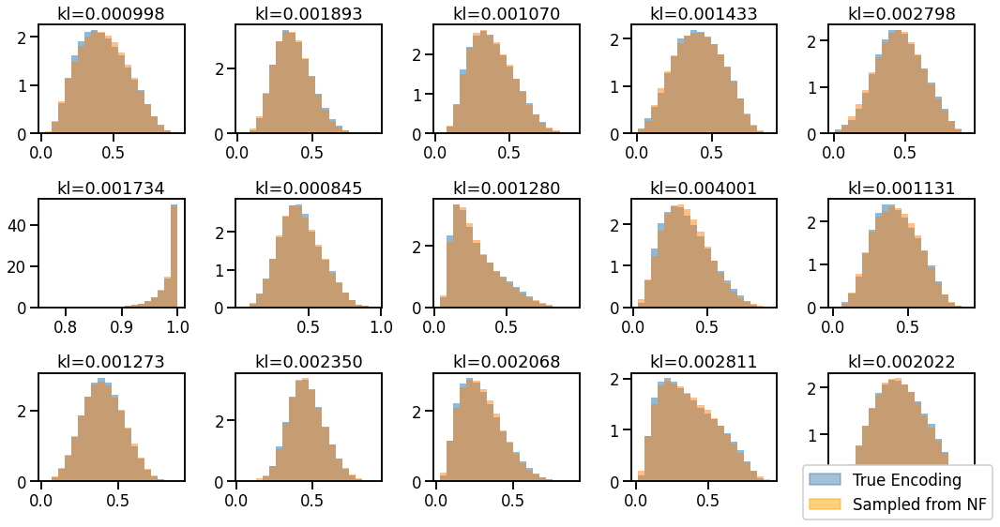

In [49]:
z_true = pae.ae.encode(dataset['x_train'])
z_sample = pae.nf.sample(dataset['x_train'].shape[0])

latent_space_plot(z_true, z_sample, save_path='plots/latent_space.png')

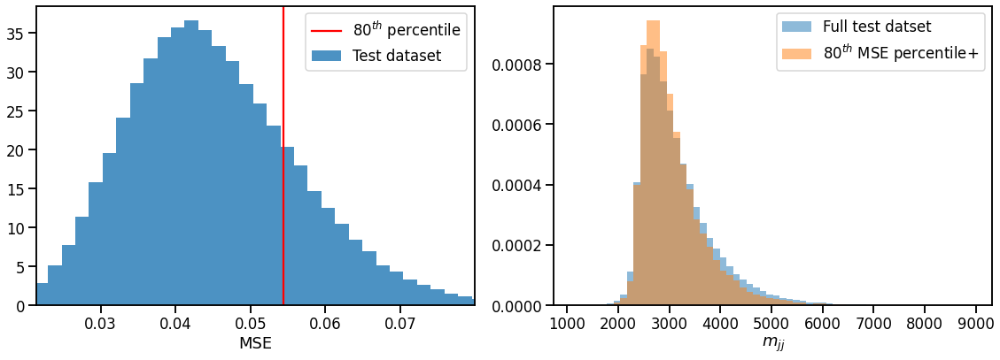

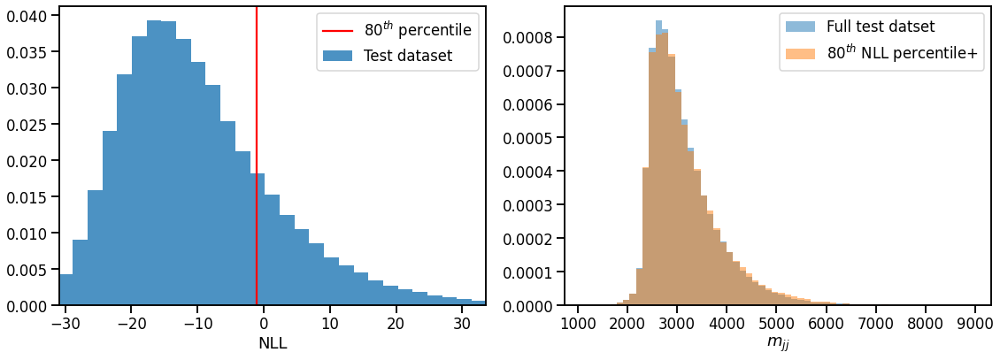

(array([4042.06789277, 3232.84575278, 2730.46870284, ..., 3480.07438349,
        5723.3874646 , 2491.492563  ]),
 array([2551.86504055, 3267.08177524, 2855.37138111, ..., 2868.0122305 ,
        1864.26563428, 2491.492563  ]))

In [50]:
mse = pae.reco_error(dataset['x_train'])
pae.compute_implicit_sigma(dataset['x_valid'])
ascore = -pae.anomaly_score(dataset['x_train'])

mjj_cut_plot(mse, dataset['mjj_train'], prc=80, score_name='MSE')#, save_path='./plots/mse_cut.png')
mjj_cut_plot(ascore, dataset['mjj_train'], prc=80, score_name='NLL')

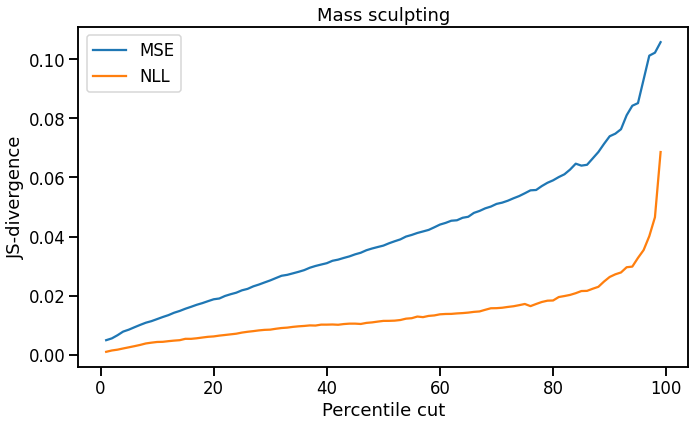

In [51]:
ano_scores = {
    'MSE': mse,
    'NLL': ascore
}

jss = sculpting_plot(ano_scores, dataset['mjj_train'], max_prc=99)

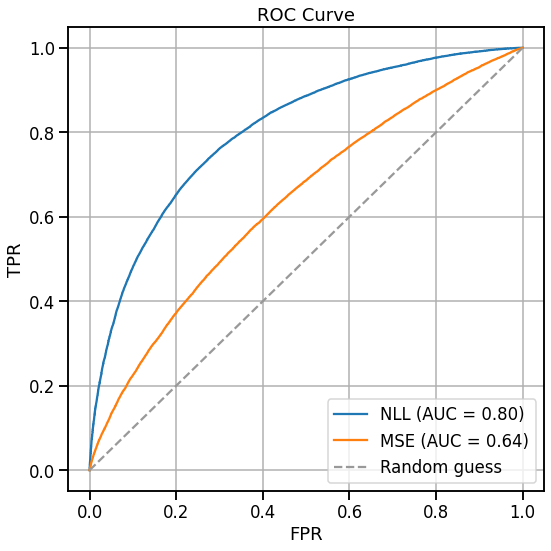

In [54]:
def binarize(label):
    return 1 if label == 'sig1' else 0

mse_test = pae.reco_error(dataset['x_test'])
ascore_test = -pae.anomaly_score(dataset['x_test'])
targets = np.array(list(map(binarize, dataset['labels'])))

scores = {
    'NLL':ascore_test,
    'MSE':mse_test
}
roc_plot(targets,scores)

In [55]:
for key, val in dataset.items():
    print(key, val.shape[0])

x_train 168304
x_valid 42069
mjj_train 168304
mjj_valid 42069
mjjj_train 168304
mjjj_valid 42069
x_test 78082
labels 100000
mjj_test 78082
mjjj_test 78082


In [57]:
df = pd.read_hdf('../data/3jet/RnD/bkgHLF_merged.h5')

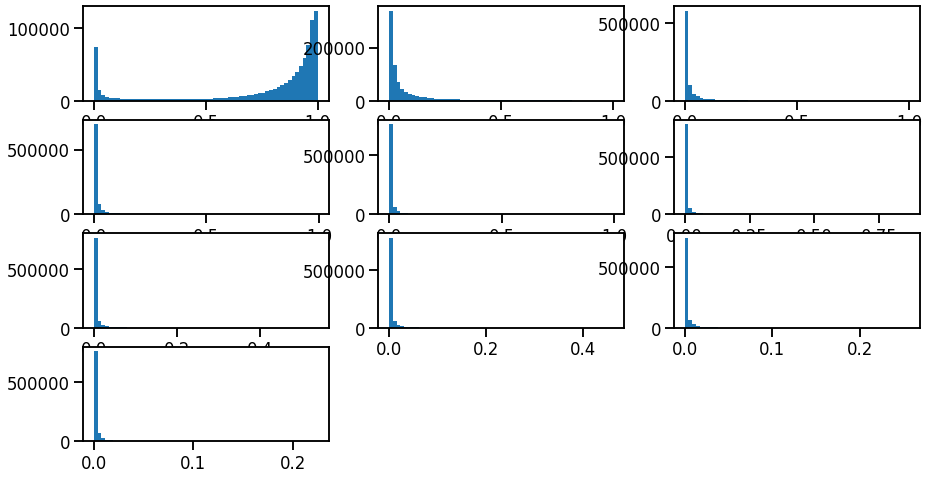

In [61]:
plt.figure(figsize=(15,8))
for i in range(10):
    plt.subplot(4,3,i+1)
    plt.hist(df[f'eRing{i}_1'], bins=60)

In [ ]:
begin = [0, 0.033, 0.066, 0.1, 0.15, 0.2, 0.3, 0.5, 0.7, 1]